<a href="https://colab.research.google.com/github/Wozik/SpeedCameraSign/blob/main/Object_Detection_for_Road_Safety.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installation

In [ ]:
# Install Dependencies
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 5.6MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44074 sha256=b886ba4a75b5c7ea544957f0d02a395969fdbf5352920a29f72da10d923cbe07
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
1.8.1+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# Install Detectron2
import torch
assert torch.__version__.startswith("1.8")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
exit(0)  # After installation, restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
     |████████████████████████████████| 6.2MB 862kB/s 
     |████████████████████████████████| 51kB 2.8MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.3.post20210317-cp37-none-any.whl size=58543 sha256=bbb2b48b177ac336e53c9ad247f2206dd952d9e10b3ec47aa8b2bdfc777bff60
  Stored in directory: /root/.cache/pip/wheels/d2/ee/3a/5c531df777c03d8c67f22c65f97d6f75321087482d05a9b218
Successfully built fvcore


In [ ]:
# Setup Detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Import common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# Import common Detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Training

In [ ]:
# Import SpeedCamera Dataset from Roboflow
!curl -L "https://app.roboflow.com/ds/ridfJKaj8L?key=WoOTUcAOBH" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0    933      0 --:--:-- --:--:-- --:--:--   932
100 5666k  100 5666k    0     0  2848k      0  0:00:01  0:00:01 --:--:-- 6794k
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/11_jpg.rf.ef338ae8eae45c86691db062018d80c5.jpg  
 extracting: test/23_jpg.rf.19a9ad3a737a51caaddd13ba91e3a1b9.jpg  
 extracting: test/27.rf.dcbca8367313e6037ba28ec4e47fb3c5.jpg  
 extracting: test/31.rf.5387dd84955107fffb09add27ee9ff98.jpg  
 extracting: test/37.rf.b24cece277039d745f3f8b9b47a38a54.jpg  
 extracting: test/41.rf.91f5d6e3ad8e5a82c3c6572fc22354ef.jpg  
 extracting: test/4_jpg.rf.b1ac8c1dd2c2ea1c2f550cfd7d4a7aa6.jpg  
 extracting: test/7.rf.a705c807bca46e931784ea88a3a54a1d.jpg  
 extracting: test/8_jpg.rf.4126c01f61dea638826c07259cfac3e8.jpg  
 extracting: test/_annot

In [ ]:
# Register data
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")

WARNING [04/25 18:20:08 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[04/25 18:20:08 d2.data.datasets.coco]: Loaded 180 images in COCO format from /content/train/_annotations.coco.json


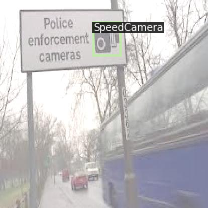

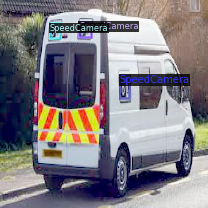

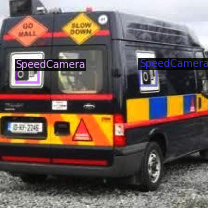

In [ ]:
# Visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
# Trainer configuration
from detectron2.engine import DefaultTrainer

# Different Detectron2 Model Zoo and Baselines https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml") # training initialized from Model Zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00100
cfg.SOLVER.MAX_ITER = 2500    # number of iterations
cfg.SOLVER.STEPS = []
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # number of classes +1

cfg.TEST.EVAL_PERIOD = 500

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[04/25 18:21:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f6e8b1.pkl: 243MB [00:21, 11.1MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.


[04/25 18:21:45 d2.engine.train_loop]: Starting training from iteration 0
[04/25 18:22:10 d2.utils.events]:  eta: 0:52:47  iter: 19  total_loss: 1.217  loss_cls: 0.977  loss_box_reg: 0.243  loss_rpn_cls: 0.04257  loss_rpn_loc: 0.008538  time: 1.2551  data_time: 0.0160  lr: 1.9981e-05  max_mem: 2556M
[04/25 18:22:36 d2.utils.events]:  eta: 0:53:23  iter: 39  total_loss: 1.116  loss_cls: 0.7024  loss_box_reg: 0.2819  loss_rpn_cls: 0.02809  loss_rpn_loc: 0.006877  time: 1.2734  data_time: 0.0073  lr: 3.9961e-05  max_mem: 2556M
[04/25 18:23:02 d2.utils.events]:  eta: 0:52:57  iter: 59  total_loss: 0.8129  loss_cls: 0.4166  loss_box_reg: 0.3959  loss_rpn_cls: 0.02344  loss_rpn_loc: 0.008621  time: 1.2866  data_time: 0.0070  lr: 5.9941e-05  max_mem: 2556M
[04/25 18:23:28 d2.utils.events]:  eta: 0:52:48  iter: 79  total_loss: 0.7541  loss_cls: 0.3318  loss_box_reg: 0.405  loss_rpn_cls: 0.02112  loss_rpn_loc: 0.00912  time: 1.2937  data_time: 0.0068  lr: 7.9921e-05  max_mem: 2556M
[04/25 18:23

# Training verification

In [ ]:
# Test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8 # treshold
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [04/25 19:23:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [04/25 19:23:24 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[04/25 19:23:24 d2.data.datasets.coco]: Loaded 9 images in COCO format from /content/test/_annotations.coco.json
[04/25 19:23:24 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category   | #instances   |
|:----------:|:-------------|:-----------:|:-------------|
|   Signs    | 0            | SpeedCamera | 11           |
|            |              |             |              |
|   total    | 11           |             |              |
[04/25 19:23:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[04/25 19:23:24 d2.data

In [ ]:
# Look at training curves in tensorboard
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Object Detection



In [ ]:
# Configuration for custom weights
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

{'instances': Instances(num_instances=1, image_height=416, image_width=416, fields=[pred_boxes: Boxes(tensor([[ 80.9420,  62.5561, 115.2007, 105.3455]], device='cuda:0')), scores: tensor([0.9997], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


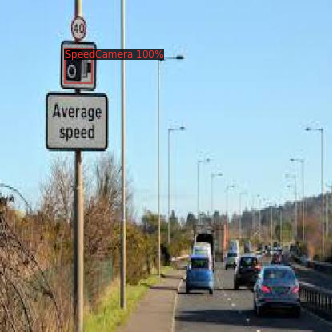

{'instances': Instances(num_instances=1, image_height=416, image_width=416, fields=[pred_boxes: Boxes(tensor([[245.5318, 172.5223, 271.6252, 209.7044]], device='cuda:0')), scores: tensor([0.9991], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


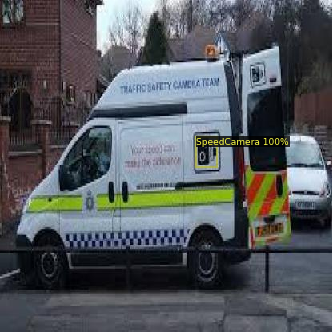

{'instances': Instances(num_instances=2, image_height=416, image_width=416, fields=[pred_boxes: Boxes(tensor([[ 76.3274,  20.9707, 134.6069,  83.8775],
        [280.6924,  21.0545, 339.3792,  83.5133]], device='cuda:0')), scores: tensor([0.9995, 0.9990], device='cuda:0'), pred_classes: tensor([1, 1], device='cuda:0')])}


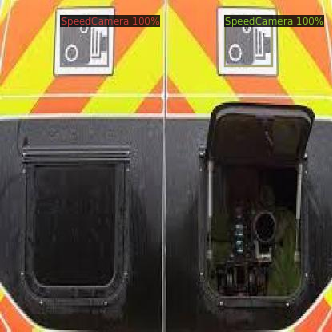

{'instances': Instances(num_instances=2, image_height=416, image_width=416, fields=[pred_boxes: Boxes(tensor([[144.4439, 164.3566, 173.9687, 198.7053],
        [291.2016, 158.6752, 308.3742, 198.7398]], device='cuda:0')), scores: tensor([0.9995, 0.9985], device='cuda:0'), pred_classes: tensor([1, 1], device='cuda:0')])}


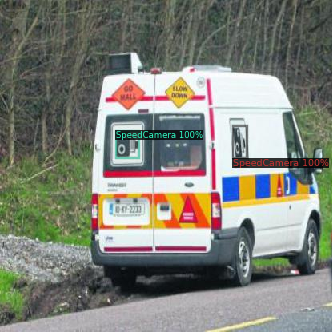

{'instances': Instances(num_instances=1, image_height=416, image_width=416, fields=[pred_boxes: Boxes(tensor([[138.1723, 138.8990, 182.4977, 197.3564]], device='cuda:0')), scores: tensor([0.9993], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


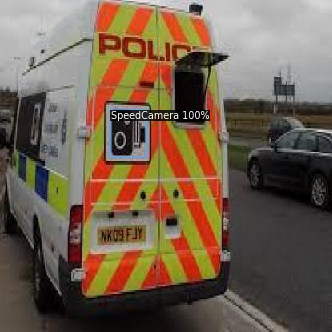

{'instances': Instances(num_instances=1, image_height=416, image_width=416, fields=[pred_boxes: Boxes(tensor([[178.4694,  47.0224, 209.9623,  86.8820]], device='cuda:0')), scores: tensor([0.9995], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


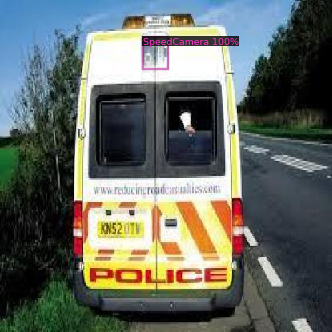

{'instances': Instances(num_instances=1, image_height=416, image_width=416, fields=[pred_boxes: Boxes(tensor([[140.0946, 135.8610, 189.1278, 188.0799]], device='cuda:0')), scores: tensor([0.9993], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


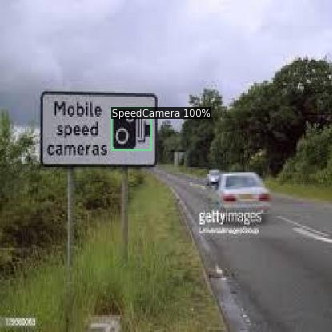

{'instances': Instances(num_instances=1, image_height=416, image_width=416, fields=[pred_boxes: Boxes(tensor([[ 98.2418, 130.8416, 115.5095, 163.3749]], device='cuda:0')), scores: tensor([0.9984], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


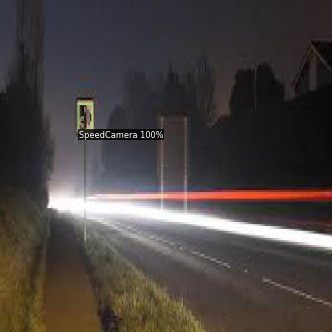

{'instances': Instances(num_instances=1, image_height=416, image_width=416, fields=[pred_boxes: Boxes(tensor([[117.5910, 225.3469, 154.9576, 270.4556]], device='cuda:0')), scores: tensor([0.9992], device='cuda:0'), pred_classes: tensor([1], device='cuda:0')])}


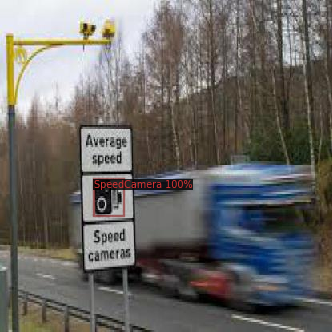

In [ ]:
# Object detection on the test dataset
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  print(outputs)
  cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# Object detection on the dashcam dataset
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/dashcam/*png'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  print(outputs)
  cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# Warning text tests

from detectron2.utils.visualizer import ColorMode

im = cv2.imread('dashcam/1.png')
#im = cv2.imread('speedCameraSign.png')
font=cv2.FONT_HERSHEY_SIMPLEX
cv2.putText(im,'!!!Be Careful!!!',(750,200),font,5,(0,0,255),8)
cv2.putText(im,'!!!Speed Camera Detected!!!',(200,400),font,5,(0,0,255),8)
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
              metadata=test_metadata, 
              scale=0.6
              )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
print(outputs)
#print(outputs["instances"].scores)
#if outputs["instances"].scores != 0 :
#  print("test")

#print(outputs["instances"].pred_boxes)
#print(num_instances)

cv2_imshow(out.get_image()[:, :, ::-1])
#print(outputs["instances"].num_instances)

{'instances': Instances(num_instances=2, image_height=480, image_width=848, fields=[pred_boxes: Boxes(tensor([[481.8424, 245.7738, 491.5162, 251.6842],
        [460.1287, 244.0069, 471.6222, 251.5721]], device='cuda:0')), scores: tensor([0.9654, 0.9314], device='cuda:0'), pred_classes: tensor([2, 2], device='cuda:0')])}


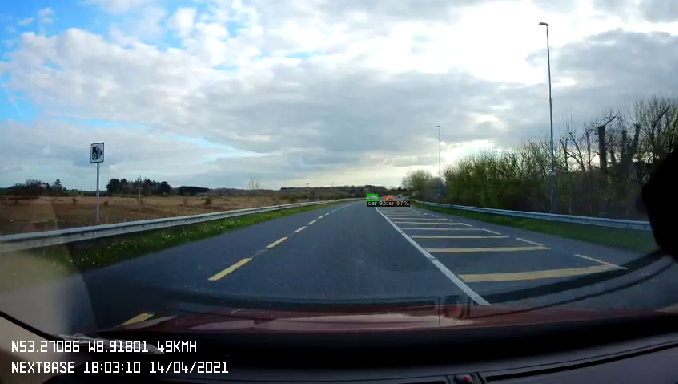

{'instances': Instances(num_instances=5, image_height=1440, image_width=2560, fields=[pred_boxes: Boxes(tensor([[1386.4592,  803.8209, 1454.6836,  861.0650],
        [1444.7911,  807.6295, 1478.7153,  837.0369],
        [1512.4493,  809.5924, 1563.5381,  849.9440],
        [1589.8337,  805.1758, 1628.5582,  833.3350],
        [1478.8940,  808.9429, 1511.4231,  830.8527]], device='cuda:0')), scores: tensor([0.9920, 0.9861, 0.9707, 0.9053, 0.8033], device='cuda:0'), pred_classes: tensor([2, 2, 2, 2, 2], device='cuda:0')])}


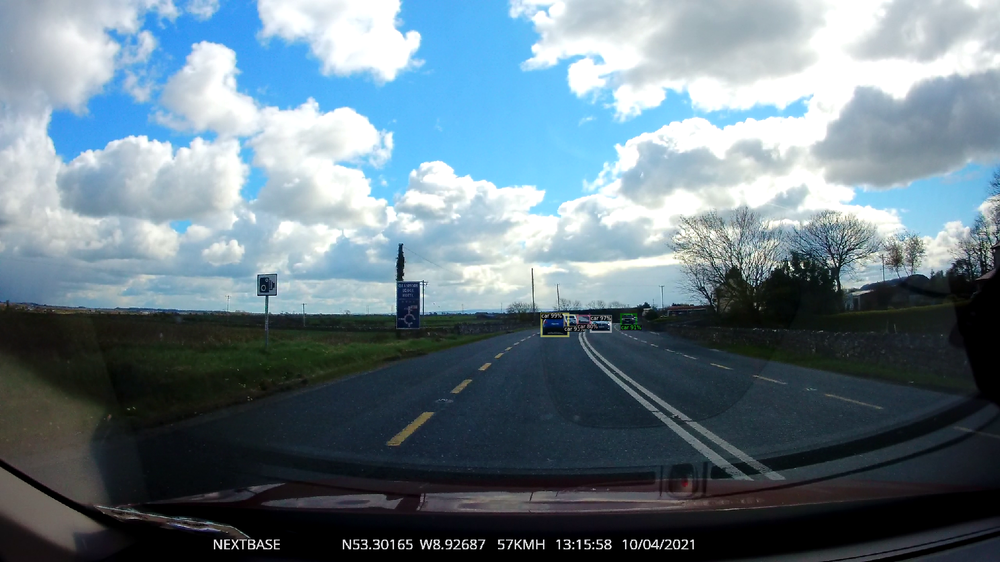

{'instances': Instances(num_instances=1, image_height=1080, image_width=1920, fields=[pred_boxes: Boxes(tensor([[ 991.9380,  423.5573, 1029.0695,  459.2504]], device='cuda:0')), scores: tensor([0.8282], device='cuda:0'), pred_classes: tensor([2], device='cuda:0')])}


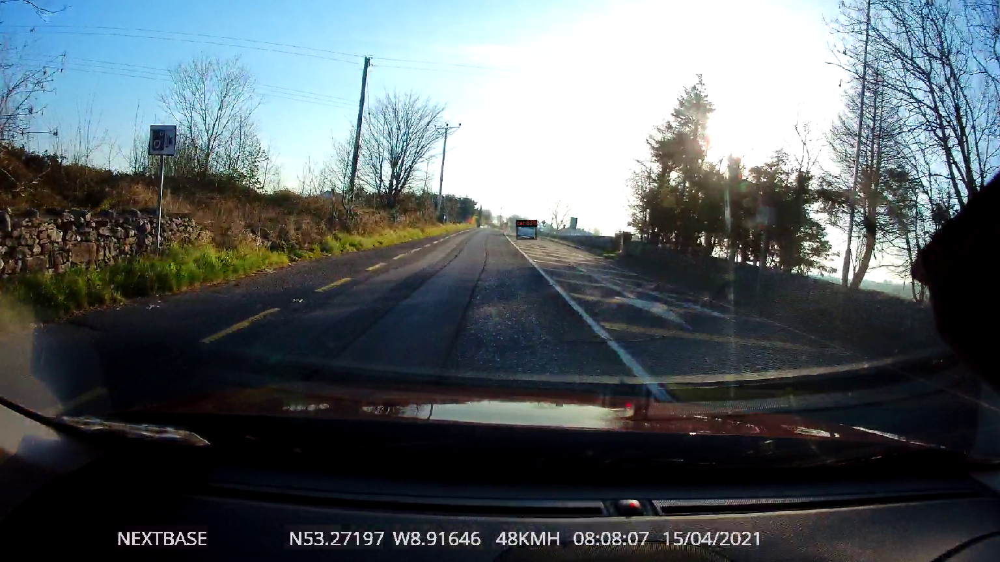

In [ ]:
# Configuration and detection for default weights on dashcam dataset
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
#outputs = predictor(im)

#im = cv2.imread("./input.jpg")
#v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=0.8)
#out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
#cv2_imshow(out.get_image()[:, :, ::-1])

from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/dashcam/*png'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=0.8)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  print(outputs)
  cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# Code for video detection
!git clone https://github.com/facebookresearch/detectron2
!python detectron2/demo/demo.py --config-file detectron2/configs/COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml --video-input test2s.mp4 --confidence-threshold 0.8 --output video-output.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-Detection/faster_rcnn_R_101_FPN_3x/137851257/model_final_f6e8b1.pkl

Cloning into 'detectron2'...
remote: Enumerating objects: 11927, done.
remote: Counting objects: 100% (590/590), done.
remote: Compressing objects: 100% (327/327), done.
remote: Total 11927 (delta 316), reused 508 (delta 260), pack-reused 11337
Receiving objects: 100% (11927/11927), 4.86 MiB | 25.15 MiB/s, done.
Resolving deltas: 100% (8596/8596), done.
[04/24 09:47:44 detectron2]: Arguments: Namespace(confidence_threshold=0.8, config_file='detectron2/configs/COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml', input=None, opts=['MODEL.WEIGHTS', 'detectron2://COCO-Detection/faster_rcnn_R_101_FPN_3x/137851257/model_final_f6e8b1.pkl'], output='video-output.mkv', video_input='test2s.mp4', webcam=False)
[04/24 09:47:48 fvcore.common.checkpoint]: Loading checkpoint from detectron2://COCO-Detection/faster_rcnn_R_101_FPN_3x/137851257/model_final_f6e8b1.pkl
[04/24 09:47:48 fvcore.common.checkpoint]: Reading a file from 'Detectron2 Model Zoo'
Could not find encoder for codec id 27: Encoder not found


In [ ]:
# Download the video detection results
from google.colab import files
files.download('video-output.mkv')

In [ ]:
# Code for webcam detection (only on local machine)
!git clone https://github.com/facebookresearch/detectron2
!python detectron2/demo/demo.py --config-file detectron2/configs/COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml --webcam
--opts MODEL.WEIGHTS detectron2://COCO-Detection/faster_rcnn_R_101_FPN_3x/137851257/model_final_f6e8b1.pkl

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!nvidia-smi
!lscpu |grep 'Model name'


Sat Apr 24 09:48:54 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    31W /  70W |   4278MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------